# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [5]:
# if plotnine is not installed in Jupter then use the following command to install it 


Running this project require the following imports 

In [6]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering

from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score
import scipy.cluster.hierarchy as shc

%matplotlib inline

In [7]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmykrbgbymkcr'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



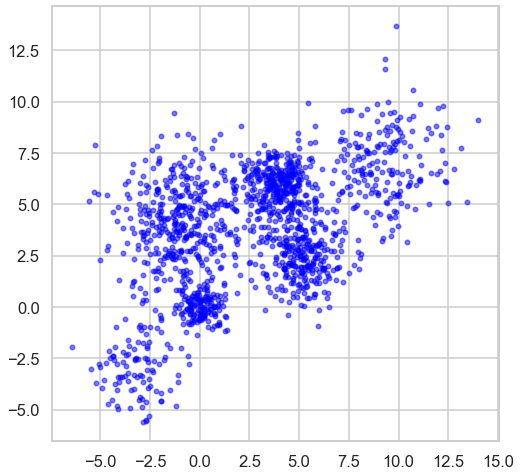

In [40]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

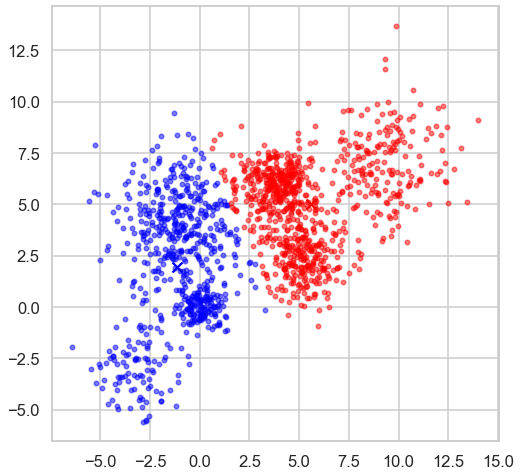

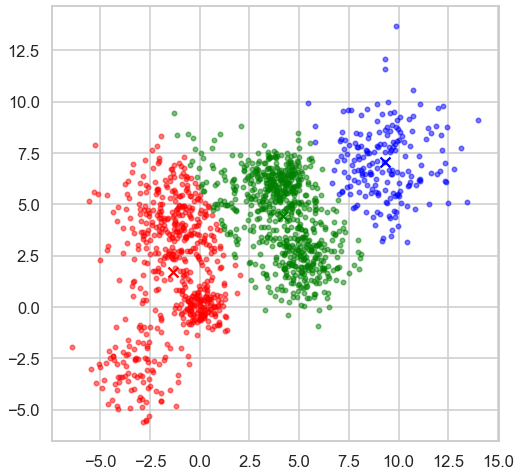

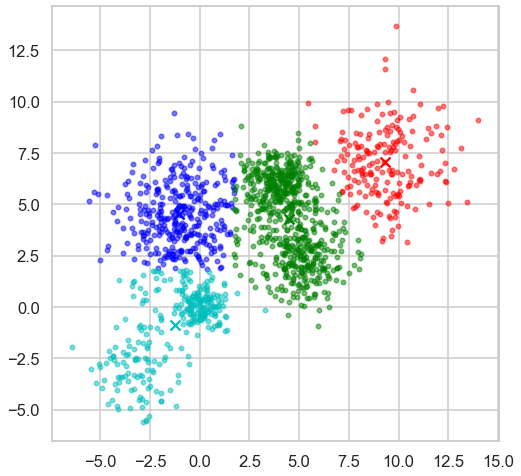

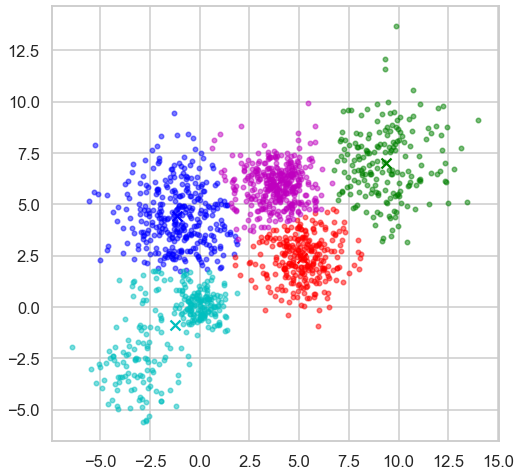

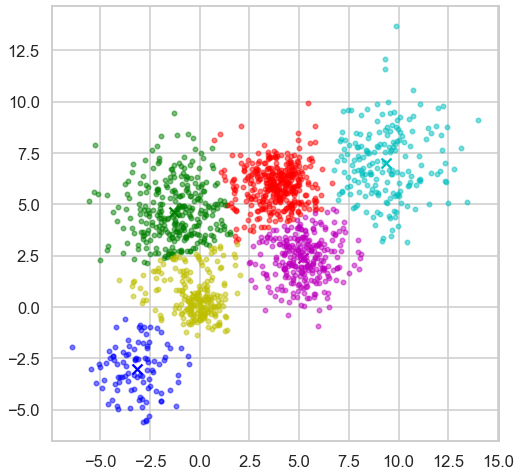

...

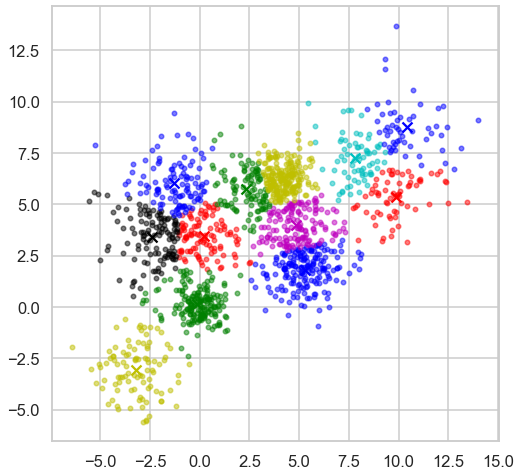

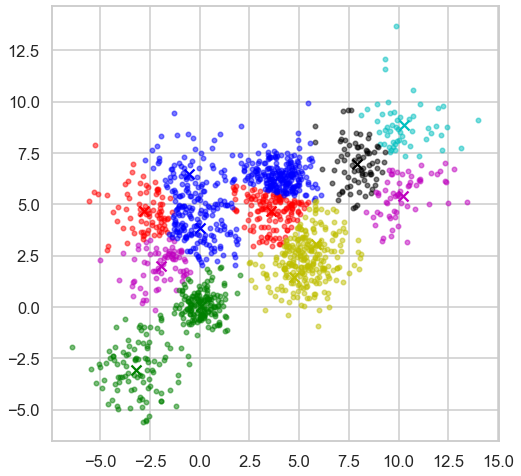

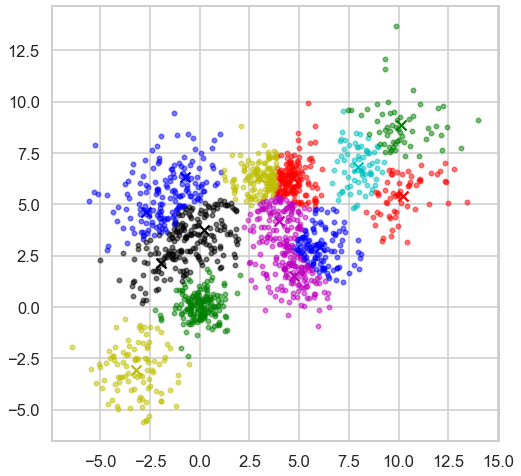

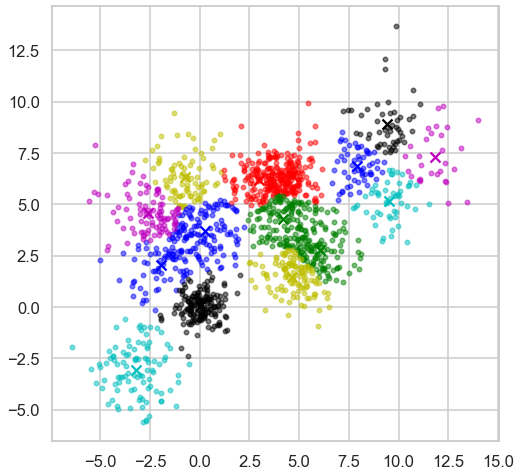

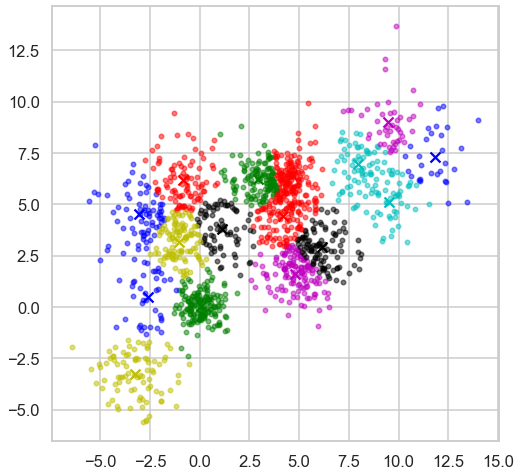

<Figure size 576x576 with 0 Axes>

In [9]:
distortion = []
score=[]
for i in range(15):
    kmeans = KMeans(n_clusters=i+2, random_state=0).fit(Multi_blob_Data)
    plt.figure()
    display_cluster(Multi_blob_Data,kmeans,num_clusters=i+2)
    distortion.append(kmeans.inertia_)
    score.append(silhouette_score(Multi_blob_Data, kmeans.labels_, metric='euclidean'))

plt.figure()
k_values=np.linspace(2,17,15)


<function matplotlib.pyplot.show(close=None, block=None)>

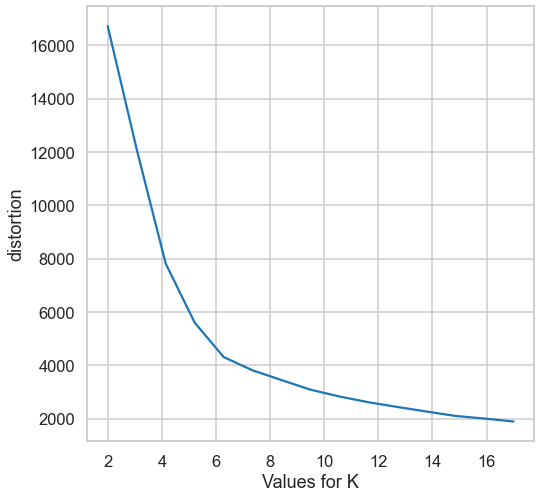

In [10]:
plt.plot(k_values,distortion)
plt.xlabel("Values for K")
plt.ylabel("distortion")
plt.show

### From the figure, the appropriate value for K can be 6 or 8

<function matplotlib.pyplot.show(close=None, block=None)>

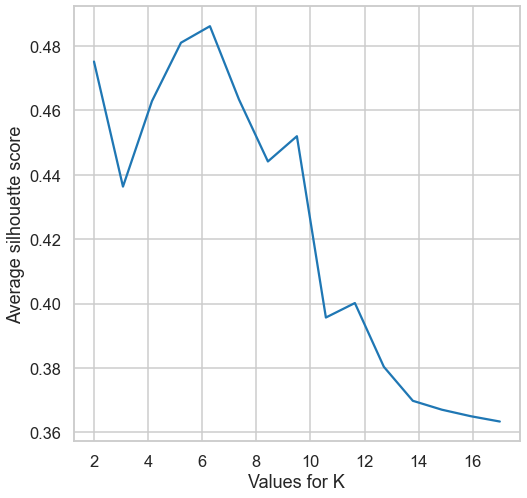

In [11]:
plt.figure()
plt.plot(k_values,score)
plt.xlabel("Values for K")
plt.ylabel("Average silhouette score")
plt.show

### Depending on silhouette score figure, it can be seen that the best value for K is 6

In [12]:
best_K_score = max(score)
best_K_score 


0.48614459735646176

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

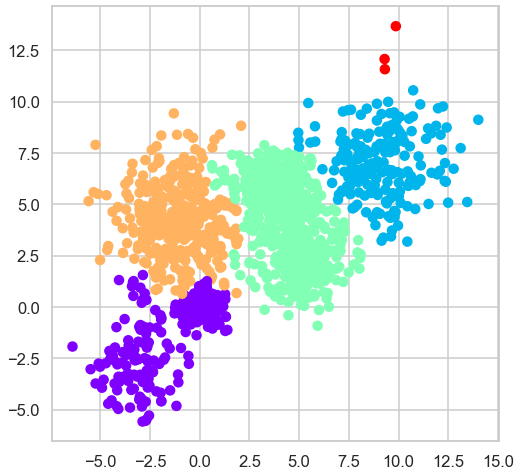

In [13]:
scores_agg=[]
Agg_cluster = AgglomerativeClustering(affinity="euclidean", linkage="average", distance_threshold=5, n_clusters=None).fit(Multi_blob_Data)
plt.figure()
plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = Agg_cluster.labels_, cmap ='rainbow')
plt.show()
scores_agg.append(silhouette_score(Multi_blob_Data, Agg_cluster.labels_, metric='euclidean'))

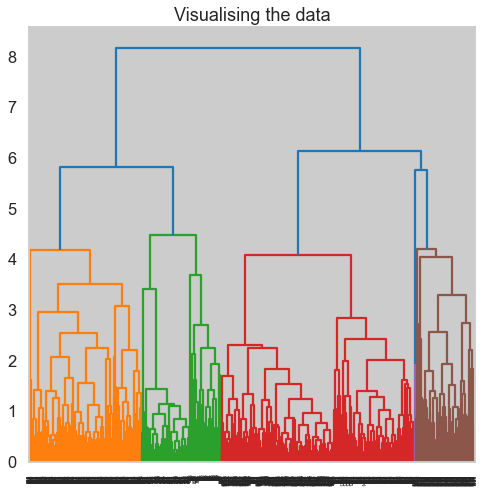

In [14]:
plt.figure()
plt.title('Visualising the data')
dendo = shc.dendrogram((shc.linkage(Multi_blob_Data, method ='average')))

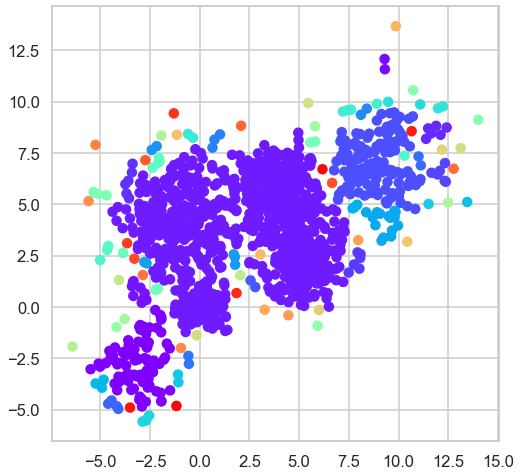

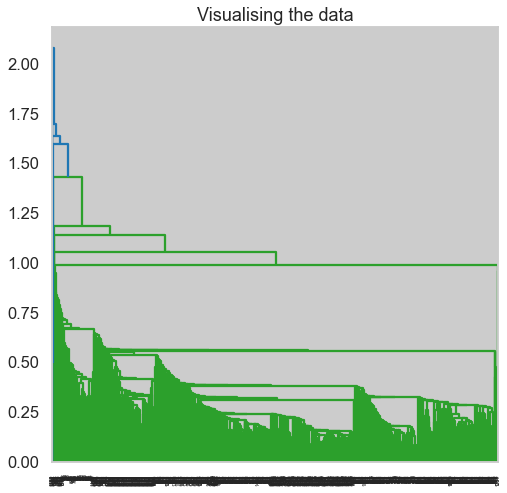

In [15]:
Agg_cluster = AgglomerativeClustering(affinity="euclidean", linkage="single", distance_threshold=0.5, n_clusters=None).fit(Multi_blob_Data)
plt.figure()
plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = Agg_cluster.labels_, cmap ='rainbow')
plt.show()
plt.figure()
plt.title('Visualising the data')
dendo = shc.dendrogram((shc.linkage(Multi_blob_Data, method ='single')))
scores_agg.append(silhouette_score(Multi_blob_Data, Agg_cluster.labels_, metric='euclidean'))

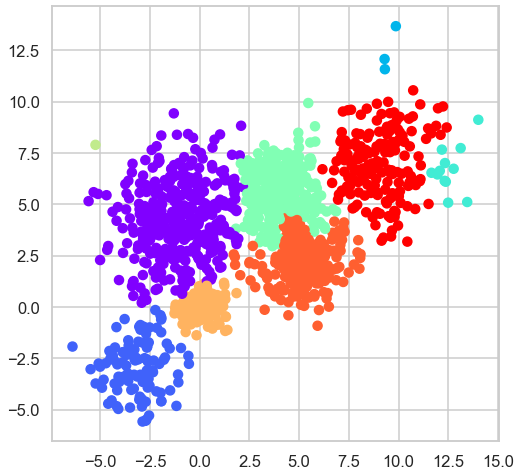

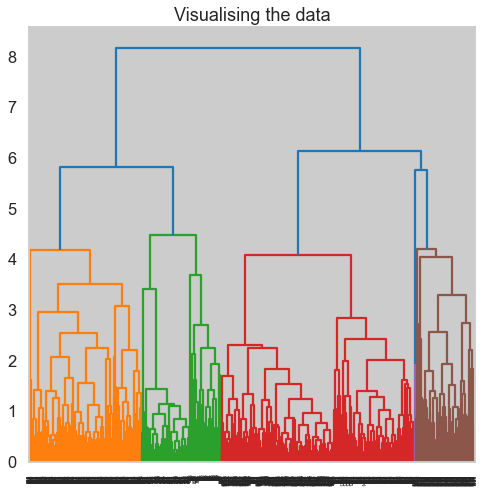

In [16]:
Agg_cluster = AgglomerativeClustering(affinity="manhattan", linkage="average", distance_threshold=5, n_clusters=None).fit(Multi_blob_Data)
plt.figure()
plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = Agg_cluster.labels_, cmap ='rainbow')
plt.show()
plt.figure()
plt.title('Visualising the data')
dendo = shc.dendrogram((shc.linkage(Multi_blob_Data, method ='average')))
scores_agg.append(silhouette_score(Multi_blob_Data, Agg_cluster.labels_, metric='manhattan'))

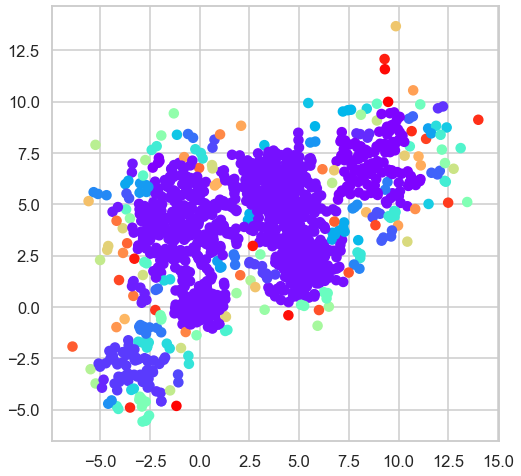

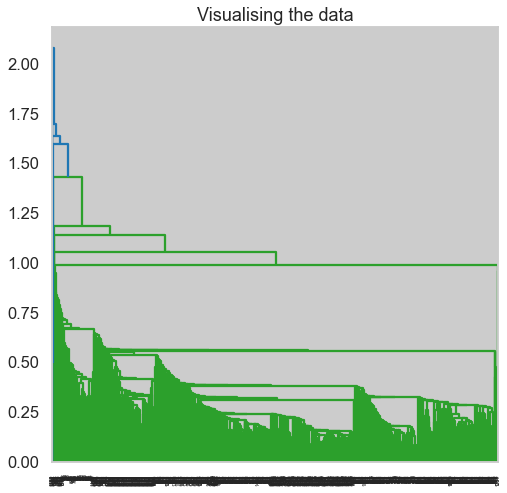

In [17]:
Agg_cluster = AgglomerativeClustering(affinity="manhattan", linkage="single", distance_threshold=0.5, n_clusters=None).fit(Multi_blob_Data)
plt.figure()
plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = Agg_cluster.labels_, cmap ='rainbow')
plt.show()
plt.figure()
plt.title('Visualising the data')
dendo = shc.dendrogram((shc.linkage(Multi_blob_Data, method ='single')))
scores_agg.append(silhouette_score(Multi_blob_Data, Agg_cluster.labels_, metric='manhattan'))

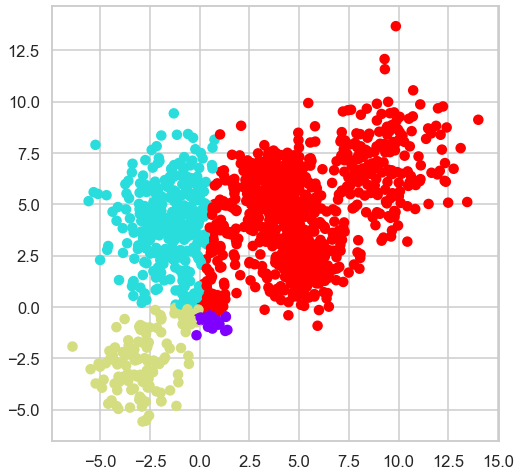

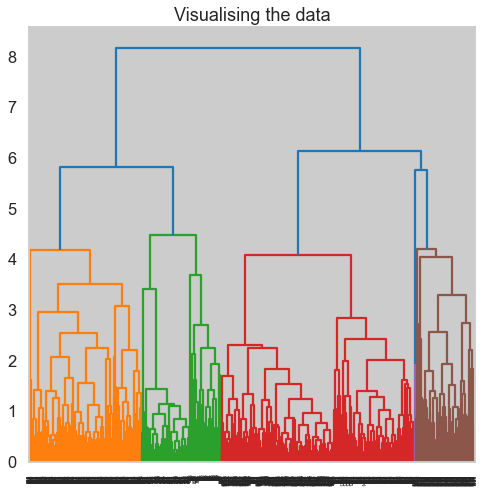

In [18]:
Agg_cluster = AgglomerativeClustering(affinity="cosine", linkage="average", distance_threshold=0.4, n_clusters=None).fit(Multi_blob_Data)
plt.figure()
plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = Agg_cluster.labels_, cmap ='rainbow')
plt.show()
plt.figure()
plt.title('Visualising the data')
dendo = shc.dendrogram((shc.linkage(Multi_blob_Data, method ='average')))
scores_agg.append(silhouette_score(Multi_blob_Data, Agg_cluster.labels_, metric='cosine'))

In [19]:
scores_agg

[0.433187948807373,
 -0.4596550259264691,
 0.3961500158920291,
 -0.48720618093491874,
 0.7813353497330464]

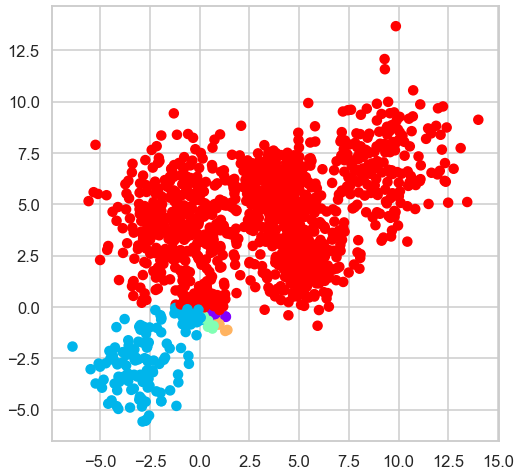

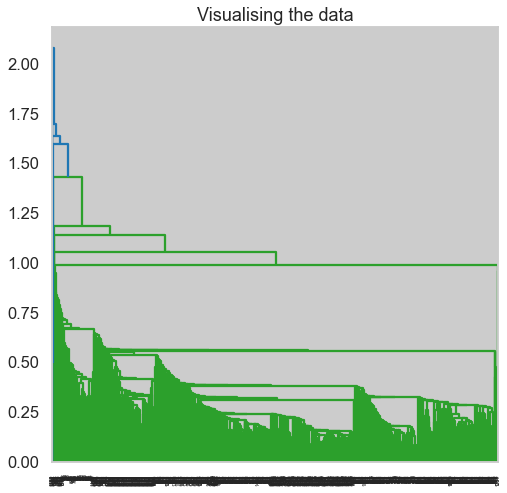

In [20]:
Agg_cluster = AgglomerativeClustering(affinity="cosine", linkage="single", distance_threshold=0.004, n_clusters=None).fit(Multi_blob_Data)
plt.figure()
plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = Agg_cluster.labels_, cmap ='rainbow')
plt.show()
plt.figure()
plt.title('Visualising the data')
dendo = shc.dendrogram((shc.linkage(Multi_blob_Data, method ='single')))
scores_agg.append(silhouette_score(Multi_blob_Data, Agg_cluster.labels_, metric='cosine'))

In [21]:

scores_agg

[0.433187948807373,
 -0.4596550259264691,
 0.3961500158920291,
 -0.48720618093491874,
 0.7813353497330464,
 0.4832362428037628]

### Negative values in scores_agg indicate that those samples might have been assigned to the wrong cluster. So, the choice for best score represents the 5th figure which was (affinity="cosine", linkage="average", distance_threshold=0.4)

In [22]:
best_agg_score = max(scores_agg)
best_agg_score

0.7813353497330464

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

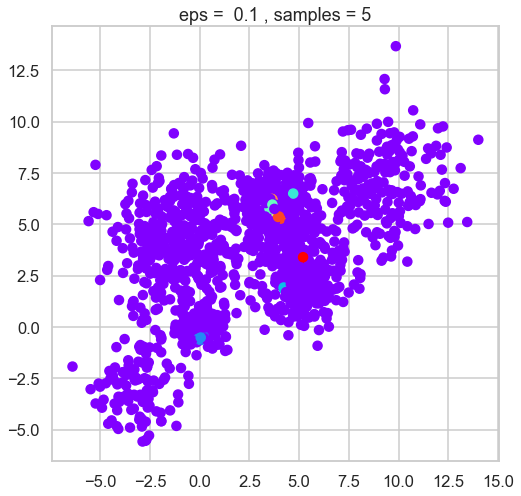

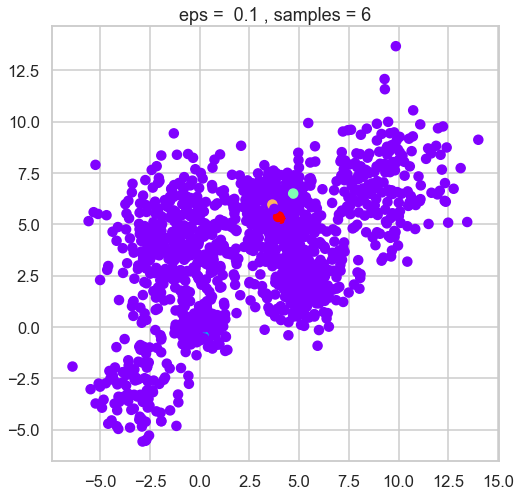

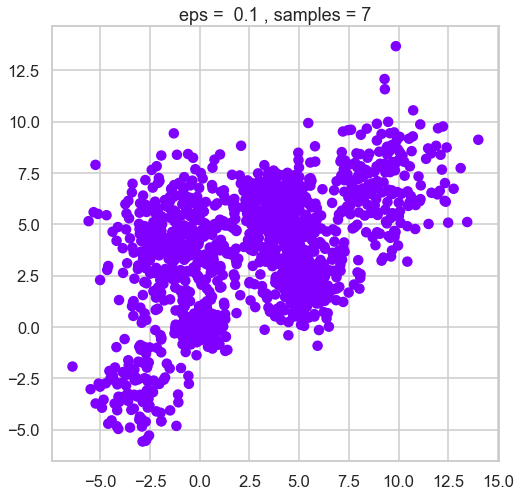

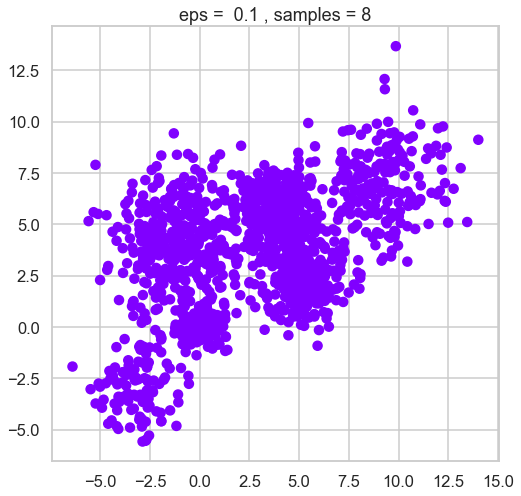

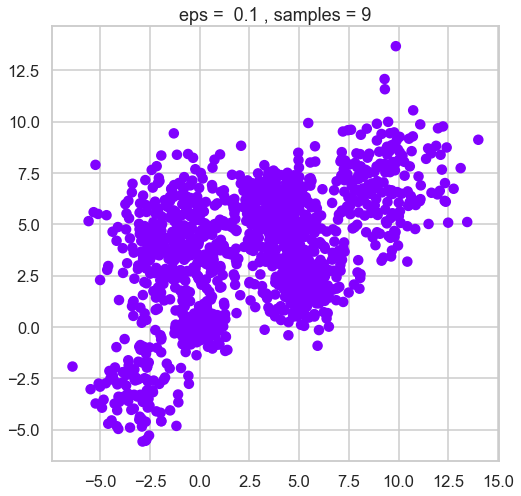

...

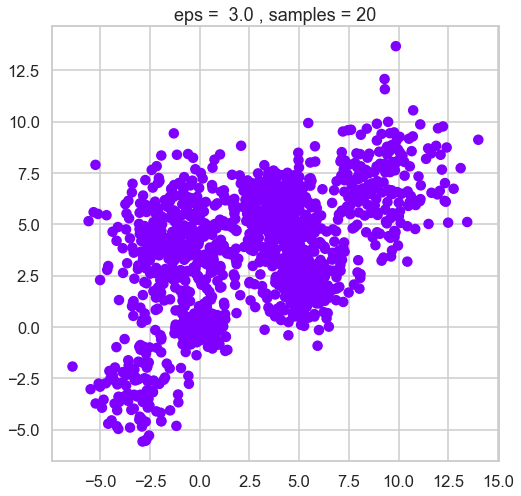

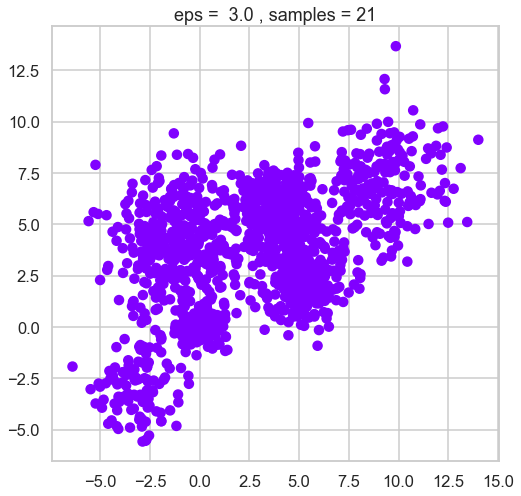

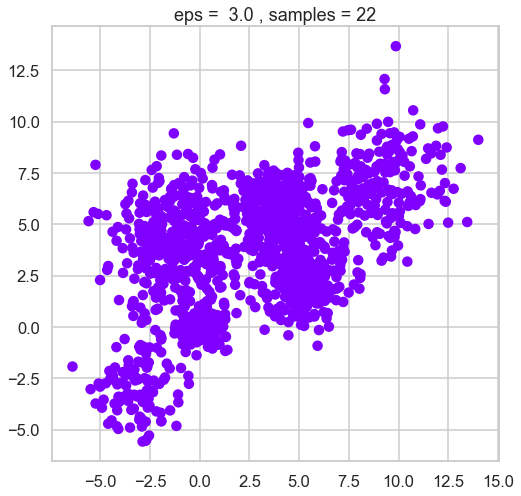

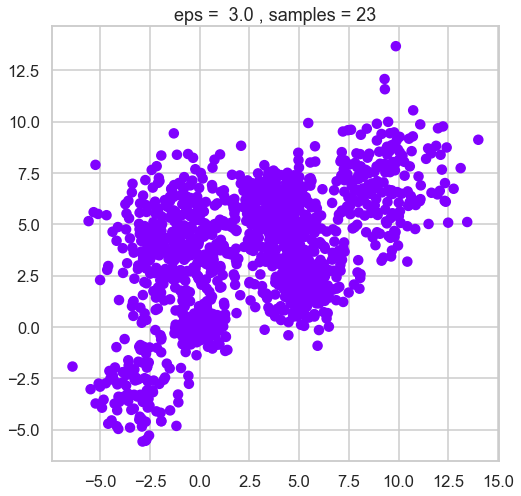

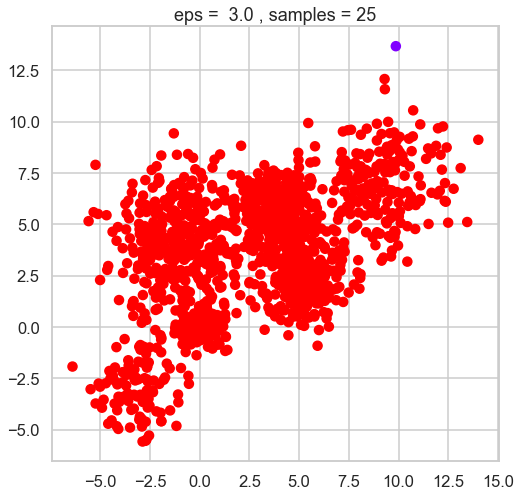

In [23]:
eps = np.linspace(0.1,3,10)
samples = np.linspace(5,25,20, dtype=int)
scores_DBscan =[]
for e in eps:
    for s in samples:
        DBscan = DBSCAN(eps=e, min_samples=s).fit(Multi_blob_Data)
        plt.figure()
        plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = DBscan.labels_, cmap ='rainbow')
        title = f'eps =  {e} , samples = {s}'
        plt.title(title)
        plt.show
        if(len(np.unique(DBscan.labels_))>1):
            scores_DBscan.append([silhouette_score(Multi_blob_Data, DBscan.labels_),e,s])


In [24]:
scores_DBscan = np.array(scores_DBscan)
scores_DBscan = scores_DBscan[scores_DBscan[:,0]>=0]


In [25]:
best_db_score_arr = scores_DBscan[np.argmax(scores_DBscan[:,0])] 
best_db_score_arr

array([ 0.46852074,  2.35555556, 11.        ])

In [26]:
best_DB_score = best_db_score_arr[0]
best_DB_score

0.4685207355522043

### From the best_db_score_arr, it is shown that the best epsilon = 2.35555556 and number_of_samples=11

Text(0.5, 1.0, 'eps =  2.3555555555555556 , samples = 11.0')

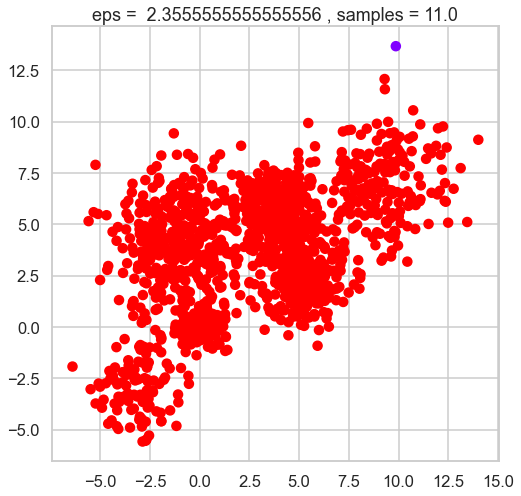

In [27]:
DBscan = DBSCAN(eps=best_db_score_arr[1], min_samples=best_db_score_arr[2]).fit(Multi_blob_Data)
plt.figure()
plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = DBscan.labels_, cmap ='rainbow')
title = f'eps =  {best_db_score_arr[1]} , samples = {best_db_score_arr[2]}'
plt.title(title)

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

In [31]:
from scipy.stats import multivariate_normal

In [84]:
def plot_contours(data,means,covs):
    plt.figure()
    plt.plot([x[0] for x in data], [y[1] for y in data],'k.') # data

    delta = 0.025
    k = len(means)
    x = np.arange(-6, 15, delta)
    y = np.arange(-6, 15, delta)
    X, Y = np.meshgrid(x, y)
    col = 'rainbow'
    for i in range(k):
        mean = means[i]
        cov = covs[i]
        sigmax = np.sqrt(cov[0][0])
        sigmay = np.sqrt(cov[1][1])
        sigmaxy = cov[0][1]/(sigmax*sigmay)
        rv = multivariate_normal([mean[0], mean[1]], [[sigmax, sigmaxy], [sigmaxy, sigmay]])
        Z = rv.pdf(np.dstack((X, Y)))
        plt.contour(X, Y, Z, cmap=col)
    plt.rcParams.update({'font.size':16})
    plt.tight_layout()

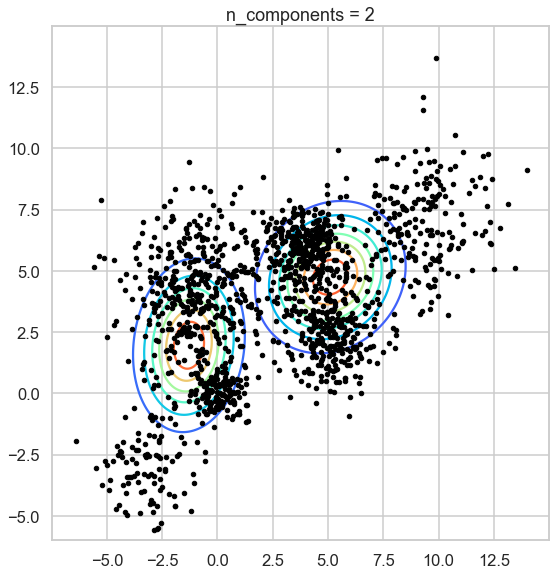

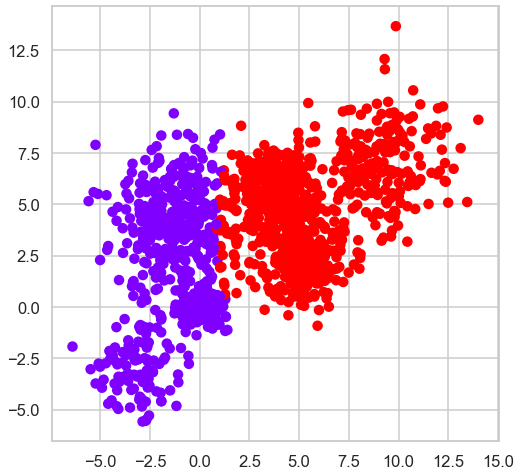

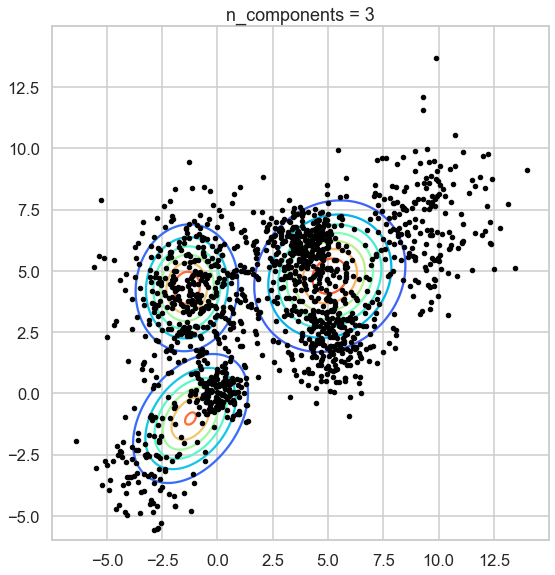

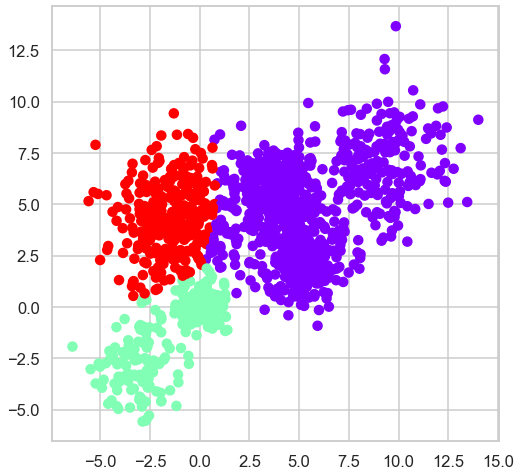

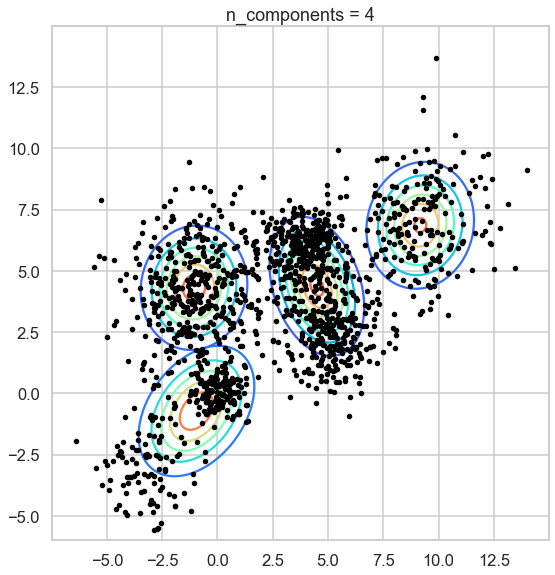

...

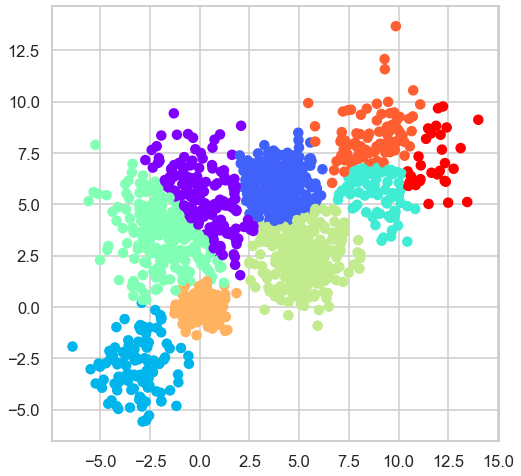

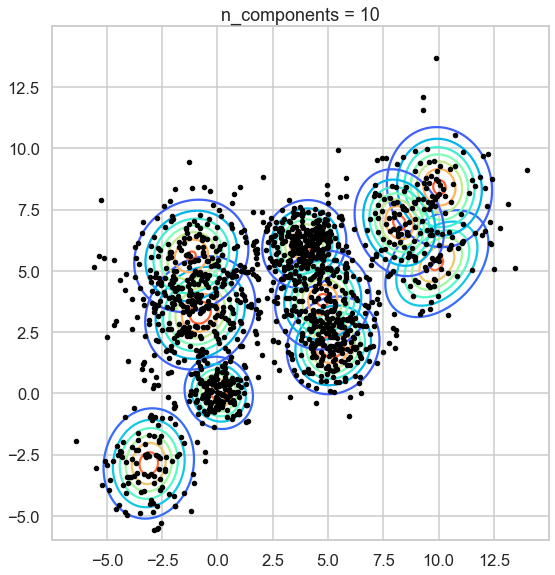

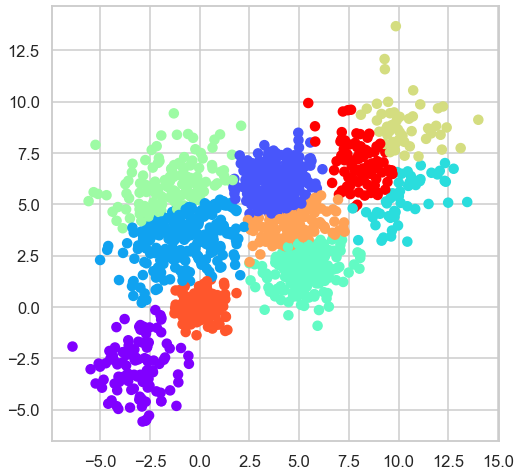

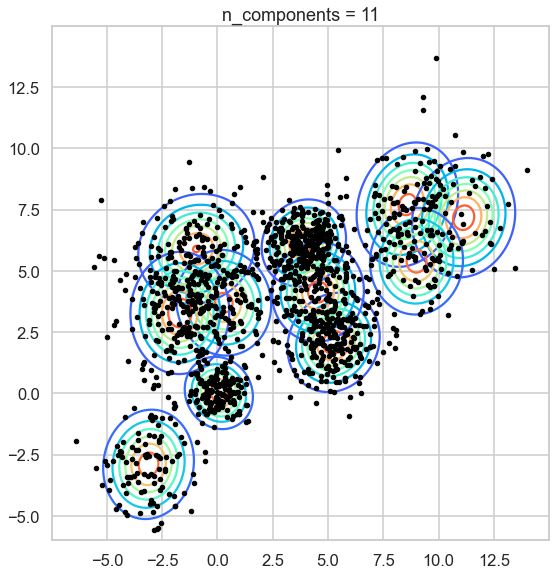

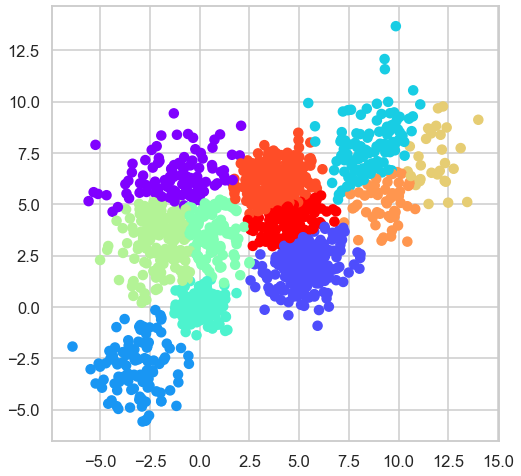

In [90]:
GM_scores = []

for i in range(10):
    gm = GaussianMixture(n_components=i+2, covariance_type="full").fit(Multi_blob_Data)

    means = gm.means_
    covariances = gm.covariances_

    plot_contours(Multi_blob_Data,means,covariances)

    GM_scores.append(silhouette_score(Multi_blob_Data, gm.predict(Multi_blob_Data)))
    title = f'n_components = {i+2}'
    plt.title(title)
    plt.figure()
    plt.scatter(Multi_blob_Data[:,0],Multi_blob_Data[:,1] ,c = gm.predict(Multi_blob_Data), cmap ='rainbow')


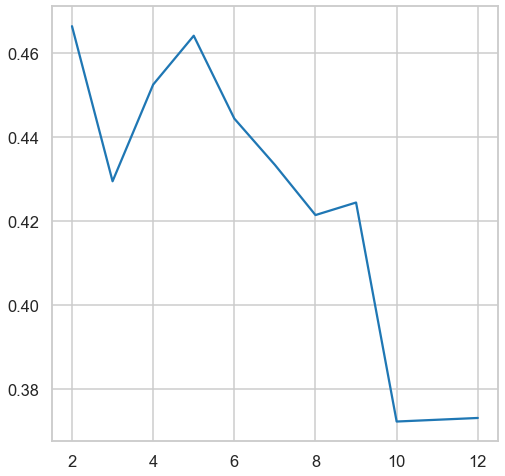

In [91]:
GM_scores = np.array(GM_scores)
x= np.linspace(2,12,10,dtype=int)
plt.plot(x,GM_scores)

In [92]:
best_gm_score = max(GM_scores)
best_gm_score

0.46648996330278436

## comparing between different algorithms

<BarContainer object of 4 artists>

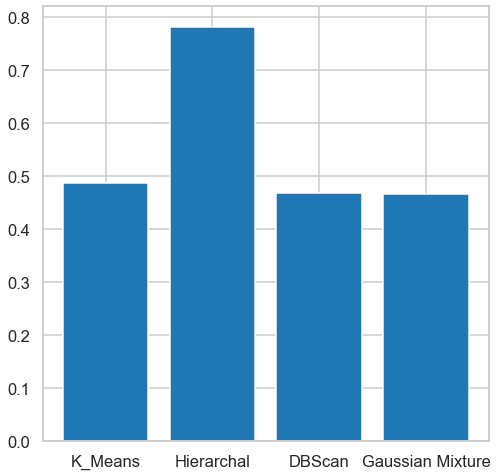

In [93]:
x_labels = ['K_Means','Hierarchal','DBScan','Gaussian Mixture']
best_scores = [best_K_score,best_agg_score,best_DB_score,best_gm_score]
plt.bar(x_labels,best_scores)

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [96]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']

data = iris_data['data']
target = iris_data['target']

In [98]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(data)
data = scaler.transform(data)


In [106]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
data_reduced = pca.fit_transform(data)


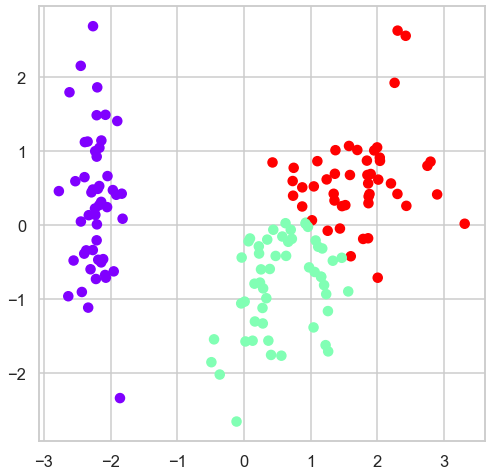

In [128]:
from sklearn.metrics import accuracy_score

accuracy_arr = []
alg = ['K_Means','Hierarchal','DBScan','Gaussian Mixture']
kmeans = KMeans(n_clusters=3, random_state=0).fit(data_reduced)
plt.figure()
plt.scatter(data_reduced[:,0],data_reduced[:,1] ,c = kmeans.labels_, cmap ='rainbow')
k_accuracy = accuracy_score(target, kmeans.predict(data_reduced))
accuracy_arr.append(k_accuracy)


0.6866666666666666

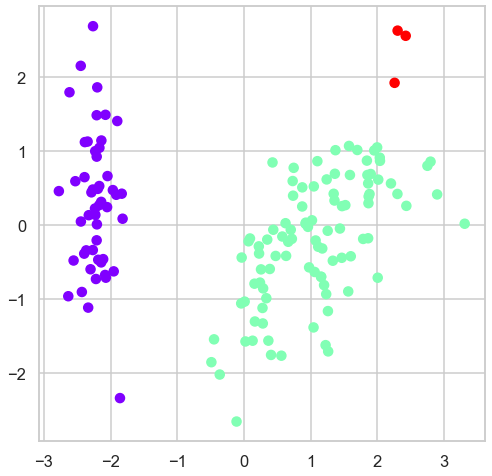

In [129]:
Agg_cluster = AgglomerativeClustering(affinity="manhattan", linkage="average", distance_threshold=None, n_clusters=3).fit(data_reduced)
agg_accuracy = accuracy_score(target, Agg_cluster.labels_)
accuracy_arr.append(agg_accuracy)
plt.figure()
plt.scatter(data_reduced[:,0],data_reduced[:,1] ,c = Agg_cluster.labels_, cmap ='rainbow')
agg_accuracy

In [130]:
db_scores =[]
for e in np.linspace(0.3,3,10):
    for m in np.linspace(2,20,18,dtype=int):
        DBscan = DBSCAN(eps=e, min_samples=m).fit(data_reduced)
        db_scores.append([accuracy_score(target, DBscan.labels_),e,m])


Text(0.5, 1.0, 'eps = 0.9000000000000001, min_samples = 2.0')

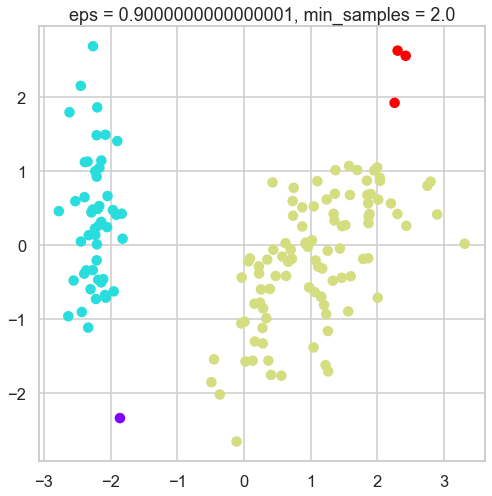

In [131]:
db_scores = np.array(db_scores)
db_best  = db_scores[np.argmax(db_scores[:,0])]
db_best
accuracy_arr.append(db_best[0])
plt.figure()
DBscan = DBSCAN(eps=db_best[1], min_samples=db_best[2]).fit(data_reduced)
plt.scatter(data_reduced[:,0],data_reduced[:,1] ,c = DBscan.labels_, cmap ='rainbow')

title = f'eps = {db_best[1]}, min_samples = {db_best[2]}'
plt.title(title)

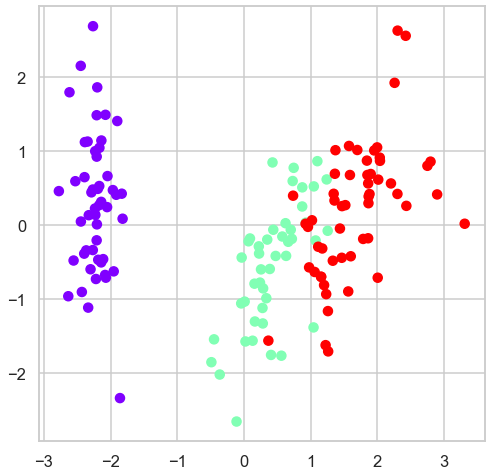

In [132]:
gm = GaussianMixture(n_components=3, covariance_type="full").fit(data_reduced)
labels = gm.fit_predict(data)
accuracy_score(target, labels)
plt.scatter(data_reduced[:,0],data_reduced[:,1] ,c = labels, cmap ='rainbow')

In [133]:
accuracy_arr.append(accuracy_score(target, labels))

[0.8333333333333334, 0.6866666666666666, 0.68, 0.9666666666666667]

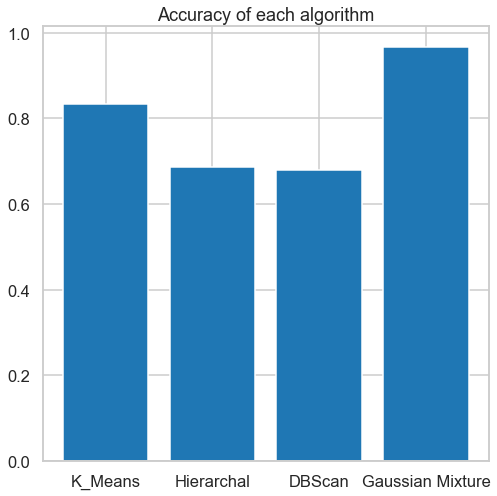

In [134]:
plt.figure()
plt.bar(alg,accuracy_arr)
plt.title('Accuracy of each algorithm')
accuracy_arr

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

## Customer dataset
Repeat all the above on the customer data set 

In [136]:
customer_df = pd.read_csv('Customer data.csv')
customer_df.head()
customer_df.drop('ID',inplace=True,axis=1)

customer_df.head()


,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,0,0,67,2,124670,1,2
1,1,1,22,1,150773,1,2
2,0,0,49,1,89210,0,0
3,0,0,45,1,171565,1,1
4,0,0,53,1,149031,1,1


In [153]:
scaler = StandardScaler()
scaler.fit(customer_df)
df_scaled = scaler.transform(customer_df)
df_scaled = pd.DataFrame(df_scaled)
np.round(df_scaled,2)
data_array=df_scaled.to_numpy()

In [154]:
pca = PCA(n_components=2)
customer_data_reduced = pca.fit_transform(data_array)

In [155]:
all_scores = []

In [156]:
K_scores = []
for i in range(20): 
    kmeans = KMeans(n_clusters=i+2, random_state=0).fit(customer_data_reduced)
    K_scores.append([silhouette_score(customer_data_reduced, kmeans.labels_),i+2])
K_scores = np.array(K_scores)
best_k =  K_scores[np.argmax(K_scores[:,0])]
best_k

array([ 0.47153693, 19.        ])

Text(0.5, 1.0, 'number of clusters = 19.0')

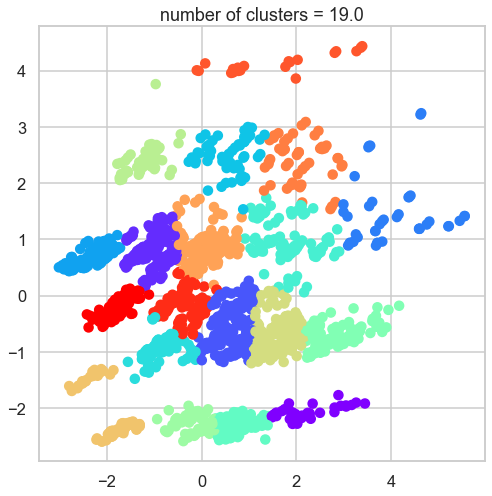

In [159]:
n = int(best_k[1])
kmeans = KMeans(n_clusters=n, random_state=0).fit(customer_data_reduced)
plt.scatter(customer_data_reduced[:,0],customer_data_reduced[:,1] ,c = kmeans.labels_, cmap ='rainbow')
title = f'number of clusters = {best_k[1]}'
plt.title(title)

In [160]:
Agg_cluster = AgglomerativeClustering(affinity="euclidean", linkage="average", distance_threshold=0.8, n_clusters=None).fit(customer_data_reduced)
silhouette_score(customer_data_reduced, Agg_cluster.labels_)

0.4562778158505606

In [161]:
all_scores.append(best_k[0])
all_scores.append(silhouette_score(customer_data_reduced, Agg_cluster.labels_))


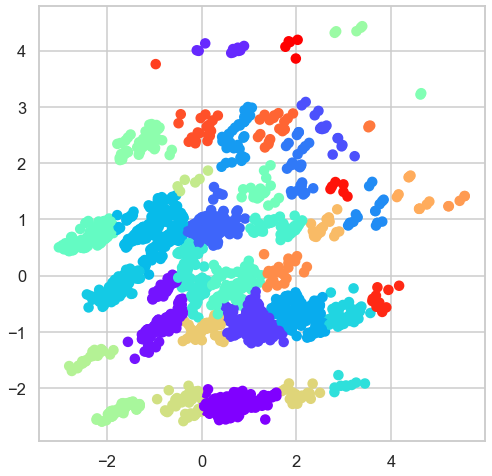

In [162]:
plt.scatter(customer_data_reduced[:,0],customer_data_reduced[:,1] ,c =  Agg_cluster.labels_, cmap ='rainbow')

In [163]:
db_scores =[]
for e in np.linspace(0.3,3,10):
    for m in np.linspace(2,10,8,dtype=int):
        DBscan = DBSCAN(eps=e, min_samples=m).fit(customer_data_reduced)
        if(len(np.unique(DBscan.labels_))>1):
            db_scores.append([silhouette_score(customer_data_reduced, DBscan.labels_),e,m])
db_scores = np.array(db_scores)
best_db =  db_scores[np.argmax(db_scores[:,0])]
best_db

array([0.51479762, 1.2       , 4.        ])

In [164]:
all_scores.append(best_db[0])

Text(0.5, 1.0, 'eps = 1.2000000000000002 , min_samples = 4')

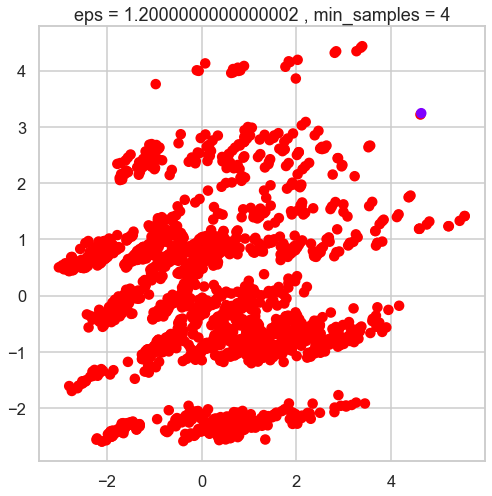

In [169]:
e = best_db[1]
min_s = int(best_db[2])
DBscan = DBSCAN(eps=e, min_samples=min_s).fit(customer_data_reduced)
plt.scatter(customer_data_reduced[:,0],customer_data_reduced[:,1] ,c =  DBscan.labels_, cmap ='rainbow')

title = f'eps = {e} , min_samples = {min_s}'
plt.title(title)

In [171]:
gm_scores = []
for i in range(20):
    gm = GaussianMixture(n_components=i+2, covariance_type="full").fit(customer_data_reduced)
    gm_scores.append([silhouette_score(customer_data_reduced, gm.predict(customer_data_reduced)),i+2])


In [172]:
gm_scores = np.array(gm_scores)
best_gm =  gm_scores[np.argmax(gm_scores[:,0])]
best_gm

array([ 0.44151192, 20.        ])

Text(0.5, 1.0, 'n_components = 20 ')

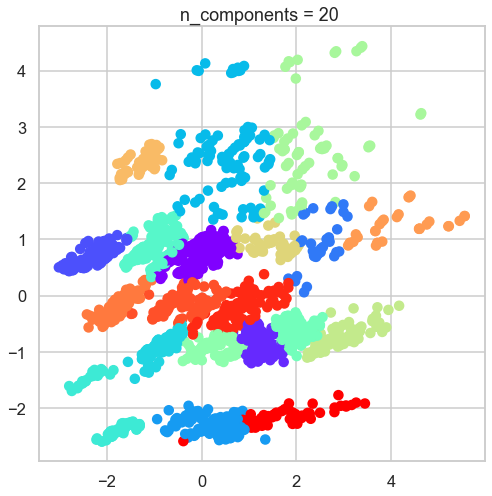

In [173]:
n_comp = int(best_gm[1])
gm = GaussianMixture(n_components=n_comp, covariance_type="full").fit(customer_data_reduced)
plt.scatter(customer_data_reduced[:,0],customer_data_reduced[:,1] ,c = gm.predict(customer_data_reduced), cmap ='rainbow')

title = f'n_components = {n_comp} '
plt.title(title)

In [174]:
all_scores.append(best_gm[0])

Text(0.5, 1.0, 'Silhouette_score of each algorithm')

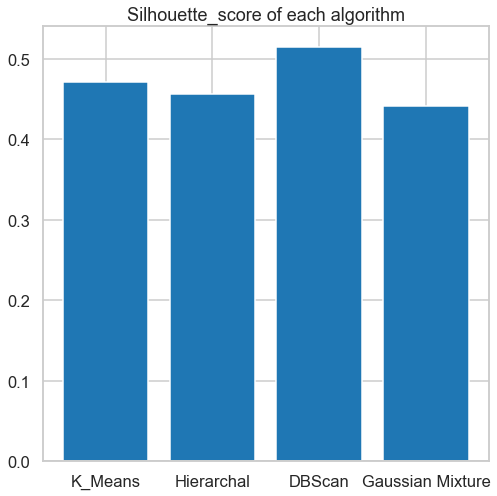

In [175]:
plt.figure()
plt.bar(alg,all_scores)
plt.title('Silhouette_score of each algorithm')